In [3]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
import pylab as pl
from scipy import stats
from sklearn.externals.six import StringIO
from sklearn import preprocessing
from sklearn import cluster, tree, decomposition
import matplotlib.pyplot as plt
import pydot

In [5]:
data = pd.read_csv("CustomerSeg")

In [7]:
data.head()

,Unnamed: 0,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,...,srch_children_cnt,srch_rm_cnt,srch_destination_id,srch_destination_type_id,is_booking,cnt,hotel_continent,hotel_country,hotel_market,hotel_cluster
0,24636210,2014-11-03 16:02:28,24,2,77,871,36643,456.1151,792280,0,...,0,1,8286,1,0,1,0,63,1258,68
1,19837144,2013-03-13 19:25:01,11,3,205,135,38749,232.4737,961995,0,...,0,1,1842,3,0,1,2,198,786,37
2,13066459,2014-10-13 13:20:25,2,3,66,314,48562,4468.2720,495669,0,...,0,1,8746,1,0,1,6,105,29,22
3,4691082,2013-11-05 10:40:34,11,3,205,411,52752,171.6021,106611,0,...,0,1,6210,3,1,1,2,198,1234,42
4,4878884,2014-06-10 13:34:56,2,3,66,174,50644,NaN,596177,0,...,1,1,12812,5,0,1,2,50,368,83


In [8]:
data.columns

Index(['Unnamed: 0', 'date_time', 'site_name', 'posa_continent',
       'user_location_country', 'user_location_region', 'user_location_city',
       'orig_destination_distance', 'user_id', 'is_mobile', 'is_package',
       'channel', 'srch_ci', 'srch_co', 'srch_adults_cnt', 'srch_children_cnt',
       'srch_rm_cnt', 'srch_destination_id', 'srch_destination_type_id',
       'is_booking', 'cnt', 'hotel_continent', 'hotel_country', 'hotel_market',
       'hotel_cluster'],
      dtype='object')

In [18]:
data.srch_co, data.srch_ci, data.is_booking

(0       2014-12-19
 1       2013-03-14
 2       2015-04-10
 3       2013-11-08
 4       2014-08-08
            ...    
 99995   2013-07-10
 99996   2013-10-01
 99997   2014-10-24
 99998   2013-07-15
 99999   2015-01-03
 Name: srch_co, Length: 100000, dtype: datetime64[ns],
 0       2014-12-15
 1       2013-03-13
 2       2015-04-03
 3       2013-11-07
 4       2014-08-03
            ...    
 99995   2013-07-06
 99996   2013-09-30
 99997   2014-10-17
 99998   2013-07-13
 99999   2014-12-31
 Name: srch_ci, Length: 100000, dtype: datetime64[ns],
 0        0
 1        0
 2        0
 3        1
 4        0
         ..
 99995    0
 99996    0
 99997    0
 99998    0
 99999    0
 Name: is_booking, Length: 100000, dtype: int64)

## Checking the statistics of the dataset

In [6]:

import pandas_profiling #This library displays the statistics information of the dataset
#Now I will use profiling command to perform EDA in just one line
pandas_profiling.ProfileReport(data)

In [11]:
# Checking date should be after Booking Date

# But before doing this. Our DataSet has some date columns which we need to set it in Pandas date column hence will set it first

data['srch_co'] = pd.to_datetime(data['srch_co'])
data['srch_ci'] = pd.to_datetime(data['srch_ci'])
data['date_time'] = pd.to_datetime(data['date_time'])
data['date'] = pd.to_datetime(data['date_time'].apply(lambda x: x.date()))





In [12]:
#Now We will Validate our Business Logic, Here I am checking the dates if they follow Business logic no. 1 Checking date should be after Booking date
# But here I am sorting those dates or observations which do not follow the business logic

data[data['srch_ci'] < data['date_time']]

,Unnamed: 0,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,...,srch_rm_cnt,srch_destination_id,srch_destination_type_id,is_booking,cnt,hotel_continent,hotel_country,hotel_market,hotel_cluster,date
1,19837144,2013-03-13 19:25:01,11,3,205,135,38749,232.4737,961995,0,...,1,1842,3,0,1,2,198,786,37,2013-03-13
5,34825186,2014-12-16 14:34:39,2,3,66,220,38273,53.7481,260938,0,...,1,3448,3,0,1,2,50,582,54,2014-12-16
28,34917790,2014-12-01 16:46:14,34,3,205,354,2433,NaN,576207,1,...,1,14875,1,0,1,2,198,750,32,2014-12-01
90,23065005,2013-11-21 15:27:28,2,3,103,45,38784,NaN,871191,0,...,1,22600,3,0,2,4,13,101,87,2013-11-21
125,36424810,2014-03-29 06:16:13,2,3,66,220,26044,NaN,306449,1,...,1,3281,3,0,1,2,50,191,72,2014-03-29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99741,1734323,2013-08-05 06:17:38,2,3,66,254,19471,NaN,672782,0,...,1,12732,5,0,2,2,50,637,72,2013-08-05
99900,36722951,2014-12-27 04:58:00,2,3,66,220,43026,159.4723,194934,1,...,1,19535,1,0,3,2,50,593,48,2014-12-27
99922,10047168,2013-09-09 12:32:37,37,1,69,879,25671,NaN,259498,0,...,1,23484,6,0,1,6,70,19,98,2013-09-09
99948,7576362,2013-08-24 07:01:37,2,3,66,315,38201,358.9412,564379,0,...,1,14806,1,0,3,2,50,618,48,2013-08-24


In [13]:
# Sorting those entries which do not follow second logic here
data[data['srch_co'] < data['srch_ci']]


,Unnamed: 0,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,...,srch_rm_cnt,srch_destination_id,srch_destination_type_id,is_booking,cnt,hotel_continent,hotel_country,hotel_market,hotel_cluster,date
36906,24695811,2014-12-09 23:29:14,37,1,69,1005,48189,NaN,993944,1,...,1,8268,1,0,1,2,50,682,26,2014-12-09
44717,25112937,2013-05-12 23:57:56,24,2,3,48,8158,NaN,18441,0,...,1,181,1,0,1,3,151,1486,26,2013-05-12


In [14]:
# Now Will be creating two new variables by substracting one existing column from other exisiting column
# New Variables will be Duration and Days in Adavance- , Let me answer this- Why am i creating these two new columns- 
# We saw above some invalid entries which do not follow the Business logic. Hence I want to put them in two different columns
def duration(row):
    delta = (row['srch_co'] - row['srch_ci'])/np.timedelta64(1, 'D')
    if delta <= 0:
        return np.nan
    else:
        return delta

def days_in_advance(row):
    delta = (row['srch_ci'] - row['date'])/np.timedelta64(1, 'D')
    if delta < 0:
        return np.nan
    else:
        return delta

data['duration'] = data.apply(duration, axis=1)
data['days_in_advance'] = data.apply(days_in_advance, axis=1)

In [15]:
data.head()

,Unnamed: 0,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,...,srch_destination_type_id,is_booking,cnt,hotel_continent,hotel_country,hotel_market,hotel_cluster,date,duration,days_in_advance
0,24636210,2014-11-03 16:02:28,24,2,77,871,36643,456.1151,792280,0,...,1,0,1,0,63,1258,68,2014-11-03,4.0,42.0
1,19837144,2013-03-13 19:25:01,11,3,205,135,38749,232.4737,961995,0,...,3,0,1,2,198,786,37,2013-03-13,1.0,0.0
2,13066459,2014-10-13 13:20:25,2,3,66,314,48562,4468.2720,495669,0,...,1,0,1,6,105,29,22,2014-10-13,7.0,172.0
3,4691082,2013-11-05 10:40:34,11,3,205,411,52752,171.6021,106611,0,...,3,1,1,2,198,1234,42,2013-11-05,1.0,2.0
4,4878884,2014-06-10 13:34:56,2,3,66,174,50644,NaN,596177,0,...,5,0,1,2,50,368,83,2014-06-10,5.0,54.0


In [21]:
cat_list = ['site_name', 'posa_continent',
       'user_location_country', 'user_location_region',
       'user_location_city', 'channel',
       'srch_destination_id', 'srch_destination_type_id',
        'hotel_continent', 'hotel_country', 'hotel_market',
       'hotel_cluster']

    
    
# booking rate per channel
data.groupby('channel')['is_booking']\
    .agg({'booking_rate': 'mean', 'num_of_bookings': 'sum'})\


,booking_rate,num_of_bookings
channel,,
0,0.071948,901
1,0.069690,716
2,0.060490,474
3,0.060400,266
4,0.120784,265
5,0.094349,581
6,0.067901,11
7,0.043157,35
8,0.055351,15


In [25]:
data.groupby('channel')['is_booking']\
    .agg({'booking_rate': 'mean', 'num_of_bookings': 'sum'})\
    .reset_index()\
    .sort_values(by='booking_rate')

,channel,booking_rate,num_of_bookings
7,7,0.043157,35
8,8,0.055351,15
3,3,0.060400,266
2,2,0.060490,474
6,6,0.067901,11
1,1,0.069690,716
0,0,0.071948,901
9,9,0.085381,4726
5,5,0.094349,581
4,4,0.120784,265


In [26]:
# Now let's look at the overall booking rate , We are taking average of it, It is 0.079

# Let's say  "I can say this channel has lowest booking rate than other channels, But We need a proof for that- Hence will use t test
data['is_booking'].mean()

0.07993

In [31]:
def stats_comparison(i):
    data.groupby(i)['is_booking'].agg({
    'average': 'mean',
    'bookings': 'count'
    }).reset_index()
    cat = data.groupby(i)['is_booking']\
        .agg({
            'sub_average': 'mean',
            'sub_bookings': 'count'
       }).reset_index()
    cat['overall_average'] = data['is_booking'].mean()
    cat['overall_bookings'] = data['is_booking'].count()
    cat['rest_bookings'] = cat['overall_bookings'] - cat['sub_bookings']
    cat['rest_average'] = (cat['overall_bookings']*cat['overall_average'] \
                     - cat['sub_bookings']*cat['sub_average'])/cat['rest_bookings']
    cat['z_score'] = (cat['sub_average']-cat['rest_average'])/\
        np.sqrt(cat['overall_average']*(1-cat['overall_average'])
            *(1/cat['sub_bookings']+1/cat['rest_bookings']))
    cat['prob'] = np.around(stats.norm.cdf(cat.z_score), decimals = 10)
    cat['significant'] = [(lambda x: 1 if x > 0.9 else -1 if x < 0.1 else 0)(i) for i in cat['prob']]
    print(cat)

In [32]:
stats_comparison('user_location_city')

       user_location_city  sub_average  sub_bookings  overall_average  \
0                       0     0.000000             4          0.07993   
1                       1     0.000000             2          0.07993   
2                       3     0.235294            17          0.07993   
3                       7     0.000000             1          0.07993   
4                       8     0.000000             1          0.07993   
...                   ...          ...           ...              ...   
10774               56497     0.000000             4          0.07993   
10775               56498     0.000000             2          0.07993   
10776               56505     0.000000             1          0.07993   
10777               56506     0.000000             1          0.07993   
10778               56507     0.000000            19          0.07993   

       overall_bookings  rest_bookings  rest_average   z_score      prob  \
0                100000          99996      0.0

In [33]:
# Selection of the features depend on the domain 
num_list = ['duration', 'days_in_advance', 'orig_destination_distance', 'is_mobile',
            'is_package', 'srch_adults_cnt', 'srch_children_cnt', 'srch_rm_cnt']
city_data = data.dropna(axis=0)[num_list + ['user_location_city']]
city_groups = city_data.groupby('user_location_city').mean().reset_index().dropna(axis=0)

In [34]:
# Scaling down the magnitude 
city_groups_std = city_groups.copy()
for i in num_list:
    city_groups_std[i] = preprocessing.scale(city_groups_std[i])

In [36]:
# Initially considering K= 3 
#Using the Elbow Method, choosing a K so that the sum of the square error of the distances decrease drastically
km = cluster.KMeans(n_clusters=3, max_iter=300, random_state=None)
city_groups_std['cluster'] = km.fit_predict(city_groups_std[num_list])

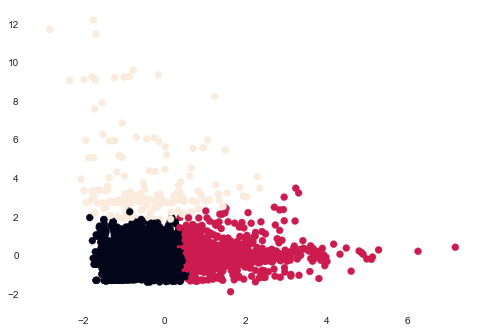

In [37]:
# Principal Component Analysis
pca = decomposition.PCA(n_components=2, whiten=True)
pca.fit(city_groups[num_list])
city_groups_std['x'] = pca.fit_transform(city_groups_std[num_list])[:, 0]
city_groups_std['y'] = pca.fit_transform(city_groups_std[num_list])[:, 1]
plt.scatter(city_groups_std['x'], city_groups_std['y'], c=city_groups_std['cluster'])
plt.show()

In [38]:
# merging the two dataframes based on a common column user_location_city, One dataframe is standardized and other is original
city_groups.merge(city_groups_std[['user_location_city', 'cluster']])\
    .groupby('cluster')\
    .mean() # for every column

,user_location_city,duration,days_in_advance,orig_destination_distance,is_mobile,is_package,srch_adults_cnt,srch_children_cnt,srch_rm_cnt
cluster,,,,,,,,,
0,28065.418321,2.752092,41.243034,1351.632387,0.143062,0.175460,1.983385,0.367814,1.073006
1,28905.677302,5.269220,101.585788,3160.171165,0.110244,0.486141,2.013648,0.320612,1.068115
2,30968.584906,3.042977,55.292086,1543.666930,0.137788,0.189832,4.203564,0.565356,2.455660
